In [13]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import math
import os

from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier

from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from sklearn.preprocessing import  LabelEncoder ,StandardScaler, OneHotEncoder,RobustScaler
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix , accuracy_score , recall_score , f1_score , classification_report
from collections import Counter
from sklearn.svm import SVC


from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer

warnings.filterwarnings('ignore')

In [14]:
import pandas as pd

# Load the dataset
file_path = '/Users/pratik/Desktop/Data Mining/Project/US_Accidents_March23.csv'  # Replace with your file path
try:
    df = pd.read_csv(file_path)
    print("Dataset loaded successfully.")
except FileNotFoundError:
    print(f"Error: File not found at {file_path}. Please check the file path.")
    df = None

# Describe the DataFrame if it's successfully loaded
if df is not None:
    print("Dataset Summary:")
    print(df.describe())
else:
    print("Unable to describe the dataset as it was not loaded.")


Dataset loaded successfully.
Dataset Summary:
           Severity     Start_Lat     Start_Lng       End_Lat       End_Lng  \
count  7.728394e+06  7.728394e+06  7.728394e+06  4.325632e+06  4.325632e+06   
mean   2.212384e+00  3.620119e+01 -9.470255e+01  3.626183e+01 -9.572557e+01   
std    4.875313e-01  5.076079e+00  1.739176e+01  5.272905e+00  1.810793e+01   
min    1.000000e+00  2.455480e+01 -1.246238e+02  2.456601e+01 -1.245457e+02   
25%    2.000000e+00  3.339963e+01 -1.172194e+02  3.346207e+01 -1.177543e+02   
50%    2.000000e+00  3.582397e+01 -8.776662e+01  3.618349e+01 -8.802789e+01   
75%    2.000000e+00  4.008496e+01 -8.035368e+01  4.017892e+01 -8.024709e+01   
max    4.000000e+00  4.900220e+01 -6.711317e+01  4.907500e+01 -6.710924e+01   

       Distance(mi)  Temperature(F)  Wind_Chill(F)   Humidity(%)  \
count  7.728394e+06    7.564541e+06   5.729375e+06  7.554250e+06   
mean   5.618423e-01    6.166329e+01   5.825105e+01  6.483104e+01   
std    1.776811e+00    1.901365e+01   

In [15]:
df.describe()

,Severity,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Speed(mph),Precipitation(in)
count,7.728394e+06,7.728394e+06,7.728394e+06,4.325632e+06,4.325632e+06,7.728394e+06,7.564541e+06,5.729375e+06,7.554250e+06,7.587715e+06,7.551296e+06,7.157161e+06,5.524808e+06
mean,2.212384e+00,3.620119e+01,-9.470255e+01,3.626183e+01,-9.572557e+01,5.618423e-01,6.166329e+01,5.825105e+01,6.483104e+01,2.953899e+01,9.090376e+00,7.685490e+00,8.407210e-03
std,4.875313e-01,5.076079e+00,1.739176e+01,5.272905e+00,1.810793e+01,1.776811e+00,1.901365e+01,2.238983e+01,2.282097e+01,1.006190e+00,2.688316e+00,5.424983e+00,1.102246e-01
min,1.000000e+00,2.455480e+01,-1.246238e+02,2.456601e+01,-1.245457e+02,0.000000e+00,-8.900000e+01,-8.900000e+01,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,2.000000e+00,3.339963e+01,-1.172194e+02,3.346207e+01,-1.177543e+02,0.000000e+00,4.900000e+01,4.300000e+01,4.800000e+01,2.937000e+01,1.000000e+01,4.600000e+00,0.000000e+00
50%,2.000000e+00,3.582397e+01,-8.776662e+01,3.618349e+01,-8.802789e+01,3.000000e-02,6.400000e+01,6.200000e+01,6.700000e+01,2.986000e+01,1.000000e+01,7.000000e+00,0.000000e+00
75%,2.000000e+00,4.008496e+01,-8.035368e+01,4.017892e+01,-8.024709e+01,4.640000e-01,7.600000e+01,7.500000e+01,8.400000e+01,3.003000e+01,1.000000e+01,1.040000e+01,0.000000e+00
max,4.000000e+00,4.900220e+01,-6.711317e+01,4.907500e+01,-6.710924e+01,4.417500e+02,2.070000e+02,2.070000e+02,1.000000e+02,5.863000e+01,1.400000e+02,1.087000e+03,3.647000e+01


Create a Sample Dataset for EDA

In [16]:
# Analyze the dataset if it's successfully loaded
if df is not None:
    # Set the target variable
    target = "Severity"

    # Quick summary of the dataset
    print("\nDataset Overview:")
    print(df.info())

    print("\nDataset Description:")
    print(df.describe())

    # Explore Target Distribution
    if target in df.columns:
        print("\nTarget Distribution in Dataset:")
        print(df[target].value_counts(normalize=True) * 100)  # Displays percentage distribution of the target variable
    else:
        print(f"\nThe target column '{target}' does not exist in the dataset.")

    # Limit dataset to 10,000 rows for EDA with stratified sampling
    if target in df.columns:
        _, dataset_sample = train_test_split(
            df, test_size=10000, stratify=df[target], random_state=42
        )

        print("\nSample Dataset Shape:")
        print(dataset_sample.shape)

        # Feature Engineering: Drop unused columns
        features_to_remove = [
            'End_Lat', 'End_Lng', 'Wind_Chill(F)', 
            'Zipcode', 'ID', 'Country', 
            'Timezone', 'Airport_Code'
        ]
        dataset_sample = dataset_sample.drop(columns=features_to_remove, axis=1, errors='ignore')

        print("\nColumns after feature removal:")
        print(dataset_sample.columns)
    else:
        print("\nTarget column not found, skipping sampling and feature engineering.")
else:
    print("Unable to analyze the dataset as it was not loaded.")


Dataset Overview:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7728394 entries, 0 to 7728393
Data columns (total 46 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   ID                     object 
 1   Source                 object 
 2   Severity               int64  
 3   Start_Time             object 
 4   End_Time               object 
 5   Start_Lat              float64
 6   Start_Lng              float64
 7   End_Lat                float64
 8   End_Lng                float64
 9   Distance(mi)           float64
 10  Description            object 
 11  Street                 object 
 12  City                   object 
 13  County                 object 
 14  State                  object 
 15  Zipcode                object 
 16  Country                object 
 17  Timezone               object 
 18  Airport_Code           object 
 19  Weather_Timestamp      object 
 20  Temperature(F)         float64
 21  Wind_Chill(F)          float64
 22 

Preprocessing Pipelines

In [17]:
# Identify columns by data type
num_cols = dataset_sample.select_dtypes(include=['float', 'int']).columns.tolist()
cat_cols = dataset_sample.select_dtypes(include=['object', 'category']).columns.tolist()
bool_cols = dataset_sample.select_dtypes(include=['bool']).columns.tolist()
datetime_cols = dataset_sample.select_dtypes(include=['datetime64']).columns.tolist()

print("\nFeature Types:")
print(f"Numeric columns: {num_cols}")
print(f"Categorical columns: {cat_cols}")
print(f"Boolean columns: {bool_cols}")
print(f"Datetime columns: {datetime_cols}")



Feature Types:
Numeric columns: ['Severity', 'Start_Lat', 'Start_Lng', 'Distance(mi)', 'Temperature(F)', 'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Speed(mph)', 'Precipitation(in)']
Categorical columns: ['Source', 'Start_Time', 'End_Time', 'Description', 'Street', 'City', 'County', 'State', 'Weather_Timestamp', 'Wind_Direction', 'Weather_Condition', 'Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight', 'Astronomical_Twilight']
Boolean columns: ['Amenity', 'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway', 'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal', 'Turning_Loop']
Datetime columns: []


Split Dataset into Features and Target

In [18]:
# Split into features and target
X = dataset_sample.drop(columns=[target])
y = dataset_sample[target]

print("\nFeatures and Target Shapes:")
print(f"X shape: {X.shape}")
print(f"y shape: {y.shape}")

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

print("\nTrain and Test Shapes:")
print(f"X_train: {X_train.shape}, y_train: {y_train.shape}")
print(f"X_test: {X_test.shape}, y_test: {y_test.shape}")



Features and Target Shapes:
X shape: (10000, 37)
y shape: (10000,)

Train and Test Shapes:
X_train: (8000, 37), y_train: (8000,)
X_test: (2000, 37), y_test: (2000,)


Define Models

In [19]:
pd.set_option('display.max_columns', None)
print(dataset_sample.head(10))


          Source  Severity                     Start_Time  \
97704    Source2         3            2016-03-25 03:15:34   
2280003  Source2         3            2019-02-16 07:50:51   
5282722  Source1         2            2023-01-23 13:18:00   
3984026  Source1         2            2022-04-04 11:44:40   
5092244  Source1         2  2022-07-08 19:14:37.000000000   
5849293  Source1         2            2021-06-11 13:18:27   
2403472  Source2         2            2018-12-24 17:59:09   
3469560  Source1         2            2016-09-29 15:17:19   
3641944  Source1         2  2023-03-24 04:31:00.000000000   
1779901  Source2         3            2019-10-31 14:01:34   

                              End_Time  Start_Lat   Start_Lng  Distance(mi)  \
97704              2016-03-25 04:15:34  34.049641 -118.214172         0.010   
2280003            2019-02-16 08:20:04  39.068787  -94.511253         0.000   
5282722            2023-01-23 14:54:06  30.052753  -81.497469         2.461   
3984026     

Handaling Null Vlues

In [20]:
null_count = dataset_sample.isnull().sum()

total_rows = len(dataset_sample)
null_percentage = (null_count / total_rows) * 100

null_df = pd.DataFrame({'Null Count': null_count, 'Null Percentage': null_percentage})
print(null_df)


                       Null Count  Null Percentage
Source                          0             0.00
Severity                        0             0.00
Start_Time                      0             0.00
End_Time                        0             0.00
Start_Lat                       0             0.00
Start_Lng                       0             0.00
Distance(mi)                    0             0.00
Description                     0             0.00
Street                         11             0.11
City                            1             0.01
County                          0             0.00
State                           0             0.00
Weather_Timestamp             174             1.74
Temperature(F)                225             2.25
Humidity(%)                   234             2.34
Pressure(in)                  195             1.95
Visibility(mi)                238             2.38
Wind_Direction                249             2.49
Wind_Speed(mph)               7

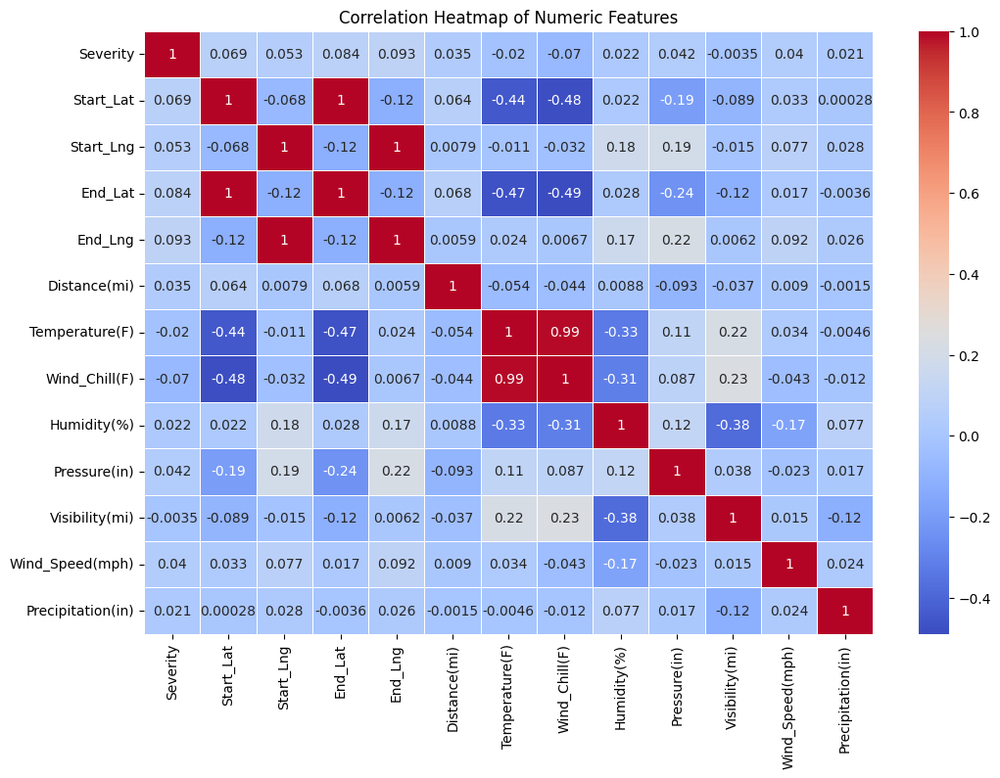

In [21]:

# Select only numeric columns for correlation calculation
numeric_df = df.select_dtypes(include=[np.number])

# Generate heatmap of correlations
plt.figure(figsize=(12, 8))
sns.heatmap(numeric_df.corr(), annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Heatmap of Numeric Features')
plt.show()


Number of accidents per year

Dataset loaded successfully.


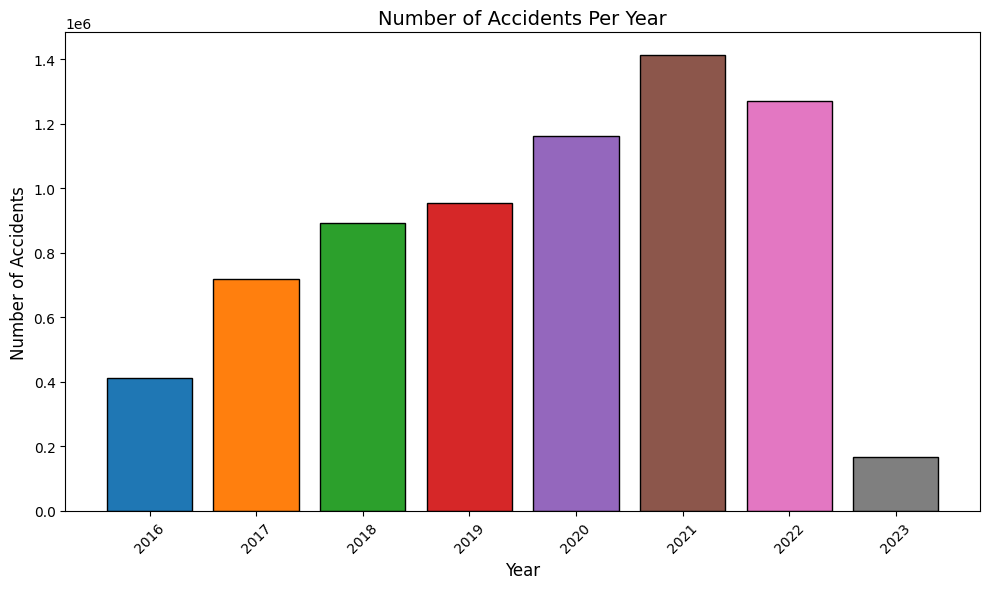

   Start_Year  Accident_Count
0        2016          410821
1        2017          717290
2        2018          893426
3        2019          954302
4        2020         1161598
5        2021         1412433
6        2022         1268806
7        2023          166552


In [22]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
file_path = '/Users/pratik/Desktop/Data Mining/Project/US_Accidents_March23.csv'  # Replace with your file path

try:
    df = pd.read_csv(file_path, parse_dates=['Start_Time'])  # Ensure Start_Time is parsed as datetime
    print("Dataset loaded successfully.")
except FileNotFoundError:
    print(f"Error: File not found at {file_path}.")
    df = None

if df is not None:
    # Check if the 'Start_Time' column exists
    if 'Start_Time' in df.columns:
        # Convert 'Start_Time' to datetime and extract year
        df['Start_Time'] = pd.to_datetime(df['Start_Time'], errors='coerce')
        df = df.dropna(subset=['Start_Time'])
        df['Start_Year'] = df['Start_Time'].dt.year

        # Group by year and count the number of accidents
        accidents_per_year = df.groupby('Start_Year').size().reset_index(name='Accident_Count')

        # Generate unique colors for each bar
        colors = plt.cm.tab10(range(len(accidents_per_year)))

        # Plot the number of accidents per year with unique colors
        plt.figure(figsize=(10, 6))
        plt.bar(accidents_per_year['Start_Year'], accidents_per_year['Accident_Count'], color=colors, edgecolor='black')
        plt.xlabel('Year', fontsize=12)
        plt.ylabel('Number of Accidents', fontsize=12)
        plt.title('Number of Accidents Per Year', fontsize=14)
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()

        # Print the DataFrame
        print(accidents_per_year)
    else:
        print("The 'Start_Time' column does not exist in the dataset.")
else:
    print("Dataset could not be loaded.")



Number of accidents per state

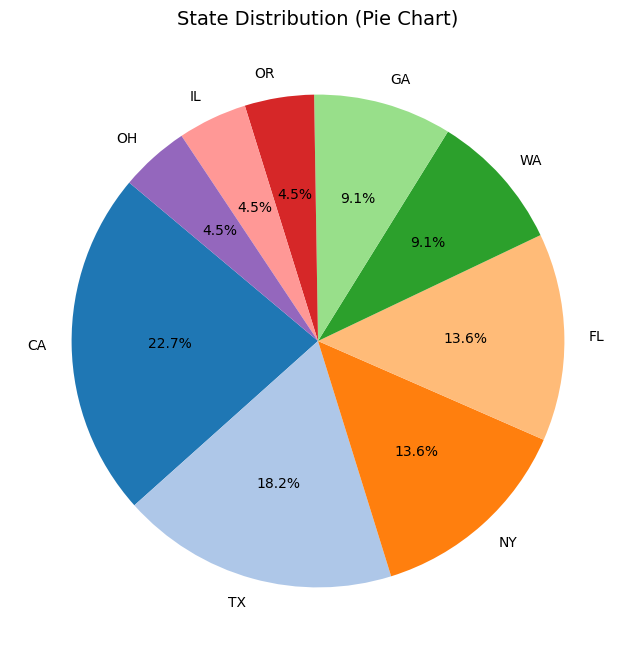

In [23]:
import pandas as pd
import matplotlib.pyplot as plt

# Example DataFrame with more states (replace this with your actual data)
data = {
    'State': ['CA', 'TX', 'NY', 'CA', 'TX', 'CA', 'NY', 'TX', 'FL', 'CA', 
              'FL', 'WA', 'OR', 'NY', 'CA', 'TX', 'GA', 'IL', 'OH', 'WA', 'FL', 'GA']
}
df_start_point = pd.DataFrame(data)

# Count values in the 'State' column
state_counts = df_start_point['State'].value_counts().reset_index()
state_counts.columns = ['State', 'Count']

# Display top 10 states only (you can change the number as needed)
top_states = state_counts.head(10)

plt.figure(figsize=(8, 8))
plt.pie(
    top_states['Count'], 
    labels=top_states['State'], 
    autopct='%1.1f%%', 
    startangle=140, 
    colors=plt.cm.tab20.colors
)
plt.title('State Distribution (Pie Chart)', fontsize=14)
plt.show()


Accidents by Year and States

In [24]:
import folium
from folium.plugins import MarkerCluster
from tqdm import tqdm
import pandas as pd

def create_zoomable_map(df, center_lat, center_lng, zoom=10, tiles='OpenStreetMap', sample_frac=0.001):
    """
    Generate a Folium Map with zoom-in and zoom-out functionality and clustered markers.
    """
    # Debugging: Ensure required columns are present
    required_cols = ['Start_Lat', 'Start_Lng', 'Severity']
    for col in required_cols:
        if col not in df.columns:
            raise ValueError(f"Missing required column: {col}")

    # Sampling the dataset for better performance on large datasets
    if len(df) > 5000:
        df = df.sample(frac=sample_frac, random_state=42)
        print(f"Sampled dataset to {len(df)} rows for faster rendering.")

    # Create the folium map
    folium_map = folium.Map(location=[center_lat, center_lng], zoom_start=zoom, tiles=tiles)
    marker_cluster = MarkerCluster().add_to(folium_map)

    # Add markers to the map
    for _, row in tqdm(df.iterrows(), total=len(df), desc="Adding Markers"):
        severity = row['Severity']
        popup_info = (
            f"<b>Severity:</b> {severity}<br>"
            f"<b>Latitude:</b> {row['Start_Lat']}<br>"
            f"<b>Longitude:</b> {row['Start_Lng']}<br>"
        )
        # Define color based on severity
        severity_color = {
            1: 'green',
            2: 'blue',
            3: 'orange',
            4: 'red'
        }.get(severity, 'gray')  # Default to gray if severity is missing

        folium.CircleMarker(
            location=[row['Start_Lat'], row['Start_Lng']],
            radius=5,
            color=severity_color,
            fill=True,
            fill_color=severity_color,
            fill_opacity=0.7,
            popup=folium.Popup(popup_info, max_width=300)
        ).add_to(marker_cluster)

    print("Zoomable map created successfully.")
    return folium_map


# Example Data (or load your own dataset)
file_path = '/Users/pratik/Desktop/Data Mining/Project/US_Accidents_March23.csv'  # Replace with actual file path
df = pd.read_csv(file_path)

# Debugging: Show available columns
print("Available columns in the dataset:")
print(df.columns)

# Generate the map
latitude = 37.7749  # Example: San Francisco latitude
longitude = -122.4194  # Example: San Francisco longitude
zoom_level = 6  # Start with a higher zoom level for a broader view
map_result = create_zoomable_map(df, latitude, longitude, zoom=zoom_level)

# Display the map in Jupyter Notebook
from IPython.display import display
display(map_result)


Available columns in the dataset:
Index(['ID', 'Source', 'Severity', 'Start_Time', 'End_Time', 'Start_Lat',
       'Start_Lng', 'End_Lat', 'End_Lng', 'Distance(mi)', 'Description',
       'Street', 'City', 'County', 'State', 'Zipcode', 'Country', 'Timezone',
       'Airport_Code', 'Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)',
       'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Direction',
       'Wind_Speed(mph)', 'Precipitation(in)', 'Weather_Condition', 'Amenity',
       'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway',
       'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal',
       'Turning_Loop', 'Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight',
       'Astronomical_Twilight'],
      dtype='object')
Sampled dataset to 7728 rows for faster rendering.


Adding Markers: 100%|██████████| 7728/7728 [00:01<00:00, 4399.85it/s]


Zoomable map created successfully.


Accident Hotspots 

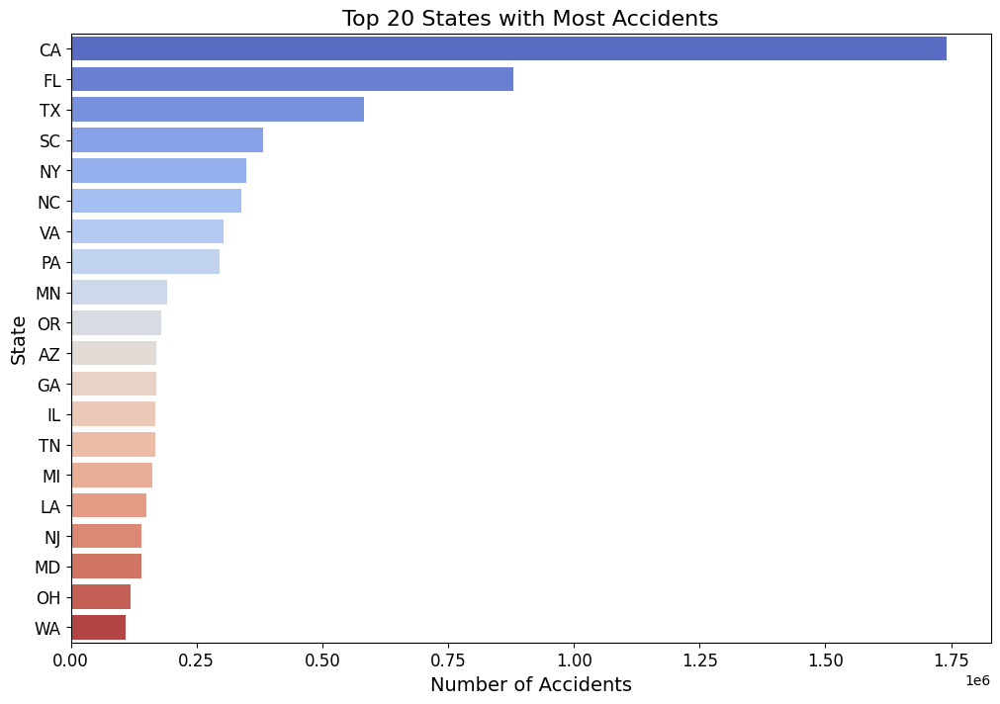

In [25]:
# Calculate proportions for severity
severity_proportions = df['Severity'].value_counts()

# Count accidents by state
state_counts = df['State'].value_counts().reset_index()
state_counts.columns = ['State', 'Count']

# Plot the heatmap
plt.figure(figsize=(12, 8))
sns.barplot(data=state_counts[:20], x='Count', y='State', palette='coolwarm')
plt.title("Top 20 States with Most Accidents", fontsize=16)
plt.xlabel("Number of Accidents", fontsize=14)
plt.ylabel("State", fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()



In [26]:
import pandas as pd

# Load your dataset
file_path = '/Users/pratik/Desktop/Data Mining/Project/US_Accidents_March23.csv'  # Replace with your dataset file path
df = pd.read_csv(file_path)

# Filter boolean columns
bool_columns = df.select_dtypes(include=['bool']).columns

# Calculate and display the percentage of True and False for each boolean column
for column in bool_columns:
    true_count = df[column].sum()
    false_count = len(df) - true_count
    true_percentage = (true_count / len(df)) * 100
    false_percentage = (false_count / len(df)) * 100

    print(f"{column}")
    print(f"Percentage of True: {true_percentage:.2f}%")
    print(f"Percentage of False: {false_percentage:.2f}%\n")


Amenity
Percentage of True: 1.25%
Percentage of False: 98.75%

Bump
Percentage of True: 0.05%
Percentage of False: 99.95%

Crossing
Percentage of True: 11.31%
Percentage of False: 88.69%

Give_Way
Percentage of True: 0.47%
Percentage of False: 99.53%

Junction
Percentage of True: 7.39%
Percentage of False: 92.61%

No_Exit
Percentage of True: 0.25%
Percentage of False: 99.75%

Railway
Percentage of True: 0.87%
Percentage of False: 99.13%

Roundabout
Percentage of True: 0.00%
Percentage of False: 100.00%

Station
Percentage of True: 2.61%
Percentage of False: 97.39%

Stop
Percentage of True: 2.77%
Percentage of False: 97.23%

Traffic_Calming
Percentage of True: 0.10%
Percentage of False: 99.90%

Traffic_Signal
Percentage of True: 14.80%
Percentage of False: 85.20%

Turning_Loop
Percentage of True: 0.00%
Percentage of False: 100.00%



Targeting Solo City (Texas)

The map below show accidents in TX for 2019

In [1]:
import pandas as pd
import folium
from folium.plugins import HeatMap
from IPython.display import display

# Load the dataset
file_path = '/Users/pratik/Desktop/Data Mining/Project/US_Accidents_March23.csv'  # Replace with your file path
try:
    df = pd.read_csv(file_path)
    print("Dataset loaded successfully.")
except FileNotFoundError:
    print(f"Error: File not found at {file_path}")
    df = None

if df is not None:
    # Check if required columns are present
    required_columns = {'Start_Lat', 'Start_Lng'}
    if not required_columns.issubset(df.columns):
        raise ValueError(f"The dataset must contain the following columns: {required_columns}")

    # Sample data for performance (if needed)
    if len(df) > 5000:
        df = df.sample(n=5000, random_state=42)
        print(f"Dataset sampled to {len(df)} rows for visualization.")

    # Create a folium map
    map_usa = folium.Map(location=[37.498831, -97.667435], tiles='cartodbpositron', zoom_start=4)

    # Add a HeatMap layer
    heat_data = df[['Start_Lat', 'Start_Lng']].dropna().values.tolist()
    HeatMap(heat_data, radius=10, blur=15).add_to(map_usa)

    # Display the map in VS Code (Jupyter Notebook extension required)
    display(map_usa)
else:
    print("Dataset could not be loaded.")



/Users/pratik/Library/Python/3.9/lib/python/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(


Dataset loaded successfully.
Dataset sampled to 5000 rows for visualization.


Accidents Due to Weather in Texas:

In [2]:
import pandas as pd
import plotly.express as px
import plotly.io as pio

import pandas as pd
import plotly.express as px
import plotly.io as pio

# Set Plotly to render in VS Code Interactive window
pio.renderers.default = 'vscode'

# Load the dataset
file_path = '/Users/pratik/Desktop/Data Mining/Project/US_Accidents_March23.csv'  # Replace with your file path

try:
    df = pd.read_csv(file_path)
    print("Dataset loaded successfully.")
except FileNotFoundError:
    print(f"Error: File not found at {file_path}.")
    df = None

if df is not None:
    # Filter for accidents in Texas
    texas_data = df[df['State'] == 'TX']

    # Check for required columns
    required_columns = {'Start_Lat', 'Start_Lng', 'Weather_Condition', 'Temperature(F)'}
    if not required_columns.issubset(texas_data.columns):
        raise ValueError(f"The dataset must contain the following columns: {required_columns}")

    # Drop rows with missing values in the required columns
    texas_weather_data = texas_data[['Start_Lat', 'Start_Lng', 'Weather_Condition', 'Temperature(F)']].dropna()

    # Create a 3D scatter plot
    fig = px.scatter_3d(
        texas_weather_data,
        x='Start_Lng',  # Longitude
        y='Start_Lat',  # Latitude
        z='Temperature(F)',  # Temperature
        color='Weather_Condition',  # Color by Weather Condition
        title='3D Scatter Plot of Accidents in Texas (Weather Conditions)',
        labels={'Start_Lng': 'Longitude', 'Start_Lat': 'Latitude', 'Temperature(F)': 'Temperature (°F)'},
        height=800
    )

    # Display the plot in VS Code Interactive window
    fig.show()





Dataset loaded successfully.


Accinteds Hotspot in Texas

In [3]:
import pandas as pd
import plotly.express as px
import plotly.io as pio

# Set Plotly to render in VS Code Interactive or browser
pio.renderers.default = 'vscode'  # Change to 'browser' if not working

# Load the dataset
file_path = '/Users/pratik/Desktop/Data Mining/Project/US_Accidents_March23.csv'  # Replace with your actual file path

try:
    df = pd.read_csv(file_path)
    print("Dataset loaded successfully.")
except FileNotFoundError:
    print(f"Error: File not found at {file_path}.")
    df = None

if df is not None:
    # Filter for accidents in Texas
    texas_data = df[df['State'] == 'TX']

    # Check for required columns
    required_columns = {'Start_Lat', 'Start_Lng'}
    if not required_columns.issubset(texas_data.columns):
        raise ValueError(f"The dataset must contain the following columns: {required_columns}")

    # Drop rows with missing values in latitude or longitude
    texas_data = texas_data[['Start_Lat', 'Start_Lng']].dropna()

    # Sample data for performance (optional for large datasets)
    if len(texas_data) > 10000:
        texas_data = texas_data.sample(n=10000, random_state=42)

    # Create a density map using Plotly
    fig = px.density_mapbox(
        texas_data,
        lat='Start_Lat',
        lon='Start_Lng',
        radius=10,
        center=dict(lat=31.9686, lon=-99.9018),
        zoom=6,
        mapbox_style='open-street-map'
    )

    fig.update_layout(
        title='Accident Hotspots in Texas',
        height=800
    )

    # Show the plot in VS Code Interactive or browser
    fig.show()
else:
    print("Dataset could not be loaded.")



Dataset loaded successfully.


Accidents by month in Texas

Dataset loaded successfully.


/var/folders/s2/xhcylgm509s026kz10p50nr40000gn/T/ipykernel_22845/3367390663.py:20: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



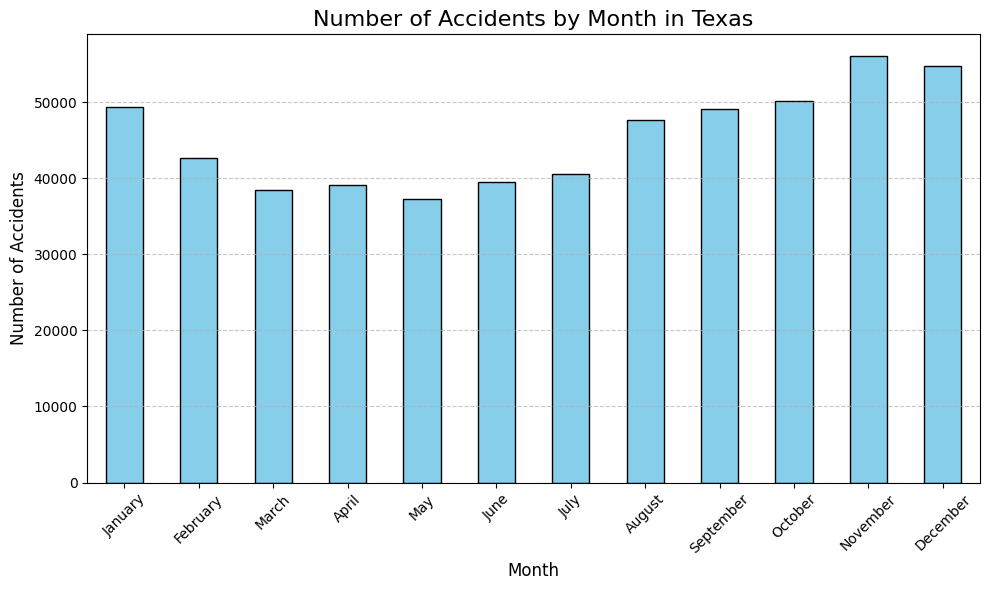

In [4]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
file_path = '/Users/pratik/Desktop/Data Mining/Project/US_Accidents_March23.csv'  # Replace with your file path
try:
    dataset = pd.read_csv(file_path)
    print("Dataset loaded successfully.")
except FileNotFoundError:
    print(f"Error: File not found at {file_path}. Please check the file path.")
    dataset = None

if dataset is not None:
    # Filter data for Texas
    texas_data = dataset[dataset['State'] == 'TX']

    # Check if 'Start_Time' column exists
    if 'Start_Time' in texas_data.columns:
        # Convert 'Start_Time' to datetime if it's not already
        texas_data['Start_Time'] = pd.to_datetime(texas_data['Start_Time'], errors='coerce')

        # Drop rows with invalid datetime values
        texas_data = texas_data.dropna(subset=['Start_Time'])

        # Extract month from 'Start_Time'
        texas_data['Month'] = texas_data['Start_Time'].dt.month

        # Count accidents by month
        accidents_by_month = texas_data['Month'].value_counts().sort_index()

        # Map month numbers to month names
        month_names = {
            1: 'January', 2: 'February', 3: 'March', 4: 'April', 5: 'May', 6: 'June',
            7: 'July', 8: 'August', 9: 'September', 10: 'October', 11: 'November', 12: 'December'
        }
        accidents_by_month.index = accidents_by_month.index.map(month_names)

        # Plot the results
        plt.figure(figsize=(10, 6))
        accidents_by_month.plot(kind='bar', color='skyblue', edgecolor='black')
        plt.title('Number of Accidents by Month in Texas', fontsize=16)
        plt.xlabel('Month', fontsize=12)
        plt.ylabel('Number of Accidents', fontsize=12)
        plt.xticks(rotation=45, fontsize=10)
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        plt.tight_layout()
        plt.show()
    else:
        print("The 'Start_Time' column is not present in the dataset.")
else:
    print("Dataset could not be loaded.")


Number of Accidents by weeks in Texas

Dataset loaded successfully.


/var/folders/s2/xhcylgm509s026kz10p50nr40000gn/T/ipykernel_22845/676514045.py:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/s2/xhcylgm509s026kz10p50nr40000gn/T/ipykernel_22845/676514045.py:36: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




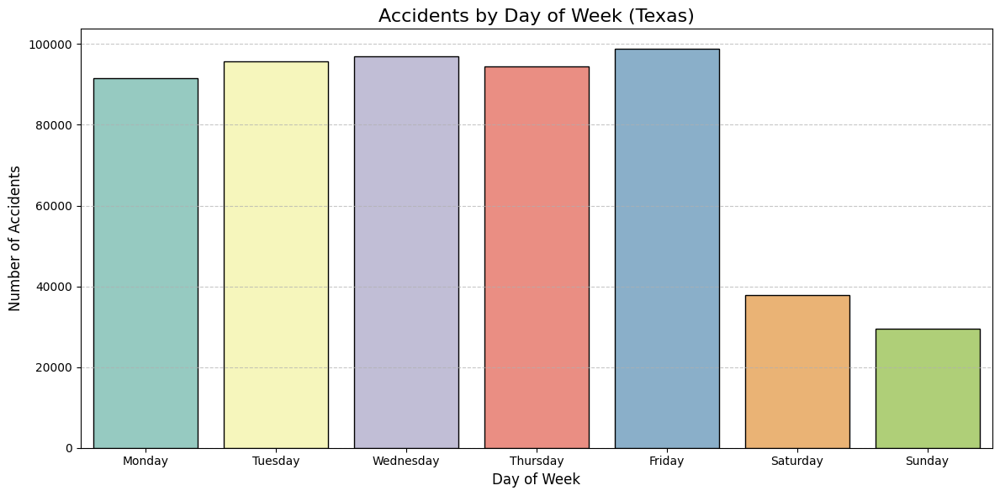

In [5]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
file_path = '/Users/pratik/Desktop/Data Mining/Project/US_Accidents_March23.csv'  # Replace with your file path
try:
    dataset = pd.read_csv(file_path)
    print("Dataset loaded successfully.")
except FileNotFoundError:
    print(f"Error: File not found at {file_path}. Please check the file path.")
    dataset = None

if dataset is not None:
    # Filter data for Texas
    texas_data = dataset[dataset['State'] == 'TX']

    # Check if 'Start_Time' column exists
    if 'Start_Time' in texas_data.columns:
        # Convert 'Start_Time' to datetime if it's not already
        texas_data['Start_Time'] = pd.to_datetime(texas_data['Start_Time'], errors='coerce')

        # Drop rows with invalid datetime values
        texas_data = texas_data.dropna(subset=['Start_Time'])

        # Extract day of the week from 'Start_Time'
        texas_data['Day_of_Week'] = texas_data['Start_Time'].dt.day_name()

        # Count accidents by day of the week
        accidents_by_day = texas_data['Day_of_Week'].value_counts().reindex([
            'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'
        ])

        # Plot accidents by day of the week
        plt.figure(figsize=(12, 6))
        sns.barplot(x=accidents_by_day.index, y=accidents_by_day.values, palette='Set3', edgecolor='black')
        plt.title('Accidents by Day of Week (Texas)', fontsize=16)
        plt.xlabel('Day of Week', fontsize=12)
        plt.ylabel('Number of Accidents', fontsize=12)
        plt.xticks(fontsize=10)
        plt.yticks(fontsize=10)
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        plt.tight_layout()
        plt.show()
    else:
        print("The 'Start_Time' column is not present in the dataset.")
else:
    print("Dataset could not be loaded.")


Number of Accidents by each hour in Texas

Dataset loaded successfully.


/var/folders/s2/xhcylgm509s026kz10p50nr40000gn/T/ipykernel_22845/1117884318.py:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



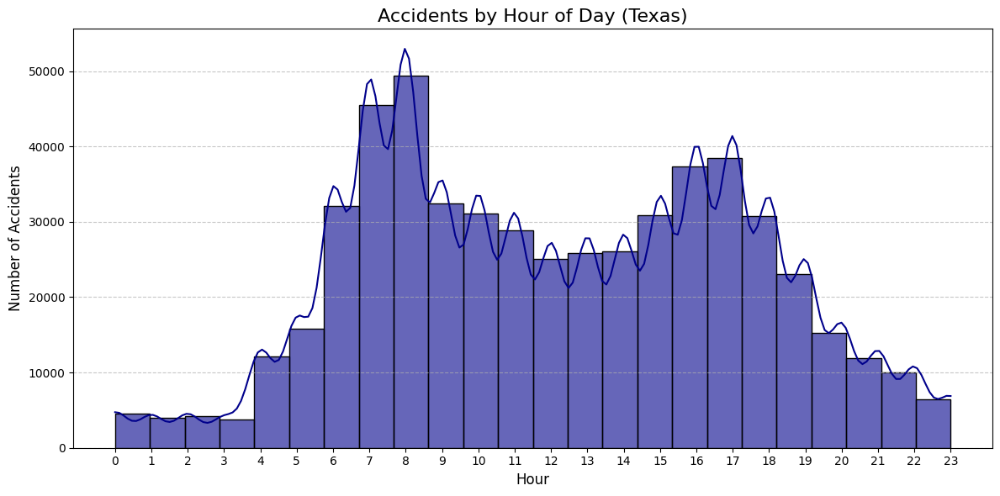

In [6]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
file_path = '/Users/pratik/Desktop/Data Mining/Project/US_Accidents_March23.csv'  # Replace with your file path
try:
    dataset = pd.read_csv(file_path)
    print("Dataset loaded successfully.")
except FileNotFoundError:
    print(f"Error: File not found at {file_path}. Please check the file path.")
    dataset = None

if dataset is not None:
    # Filter data for Texas
    texas_data = dataset[dataset['State'] == 'TX']

    # Check if 'Start_Time' column exists
    if 'Start_Time' in texas_data.columns:
        # Convert 'Start_Time' to datetime if it's not already
        texas_data['Start_Time'] = pd.to_datetime(texas_data['Start_Time'], errors='coerce')

        # Drop rows with invalid datetime values
        texas_data = texas_data.dropna(subset=['Start_Time'])

        # Extract hour from 'Start_Time'
        texas_data['Hour'] = texas_data['Start_Time'].dt.hour

        # Plot accidents by hour
        plt.figure(figsize=(12, 6))
        sns.histplot(texas_data['Hour'], bins=24, kde=True, color='darkblue', edgecolor='black', alpha=0.6)
        plt.title('Accidents by Hour of Day (Texas)', fontsize=16)
        plt.xlabel('Hour', fontsize=12)
        plt.ylabel('Number of Accidents', fontsize=12)
        plt.xticks(range(0, 24), fontsize=10)
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        plt.tight_layout()
        plt.show()
    else:
        print("The 'Start_Time' column is not present in the dataset.")
else:
    print("Dataset could not be loaded.")


OutlineOutlier Detection and Handling

Dataset loaded successfully.

Analyzing column: Temperature(F)


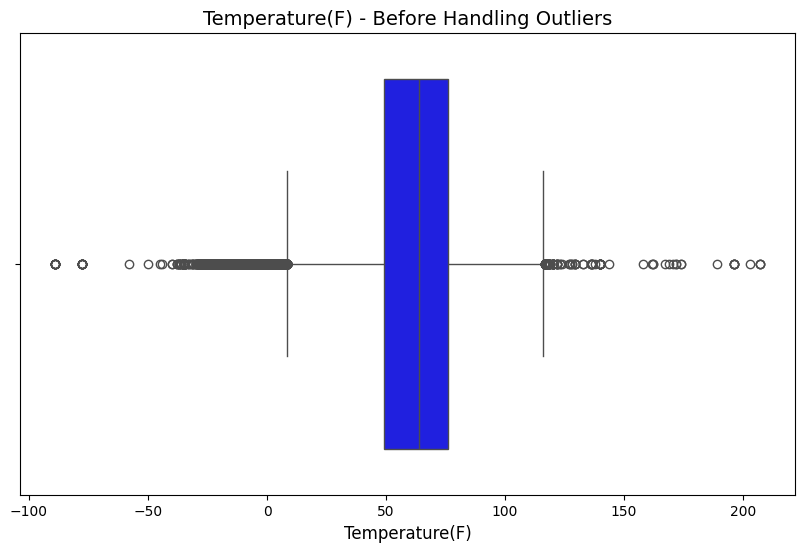


50515 outliers detected in 'Temperature(F)' column.
Lower Bound: 8.50, Upper Bound: 116.50
Outliers handled in 'Temperature(F)'.
Visualizing Temperature(F) after handling outliers:


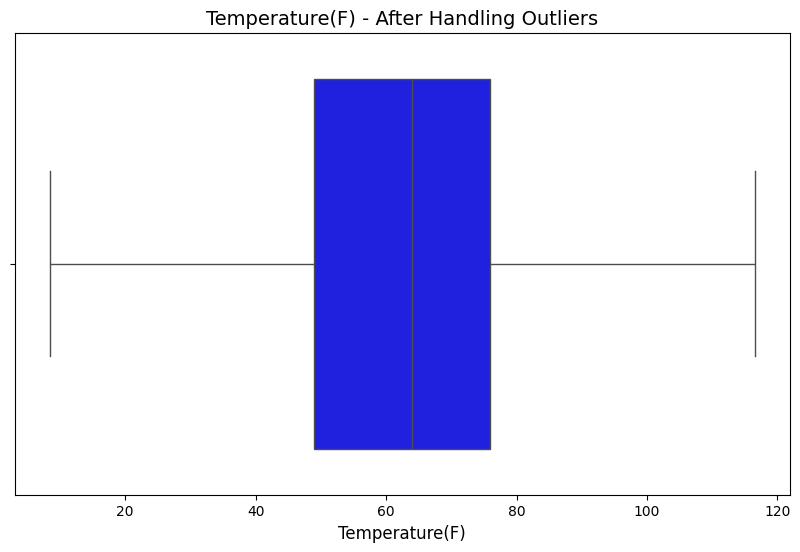


Analyzing column: Visibility(mi)


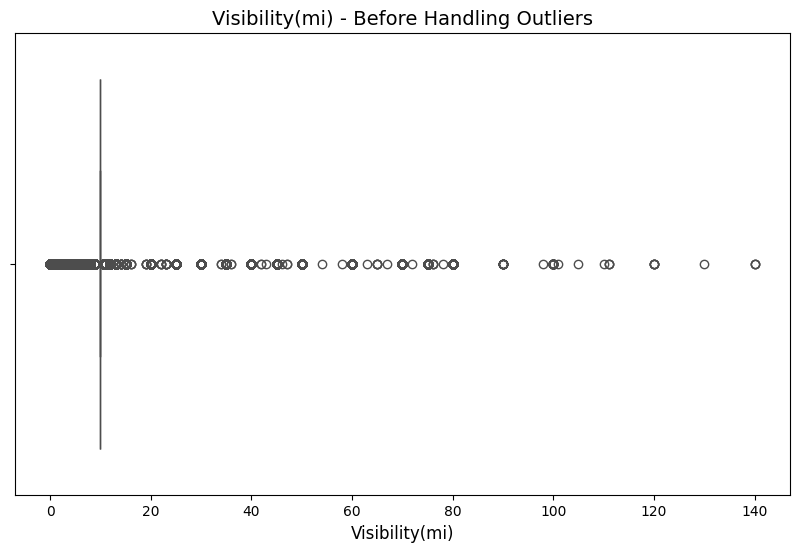


1481065 outliers detected in 'Visibility(mi)' column.
Lower Bound: 10.00, Upper Bound: 10.00
Outliers handled in 'Visibility(mi)'.
Visualizing Visibility(mi) after handling outliers:


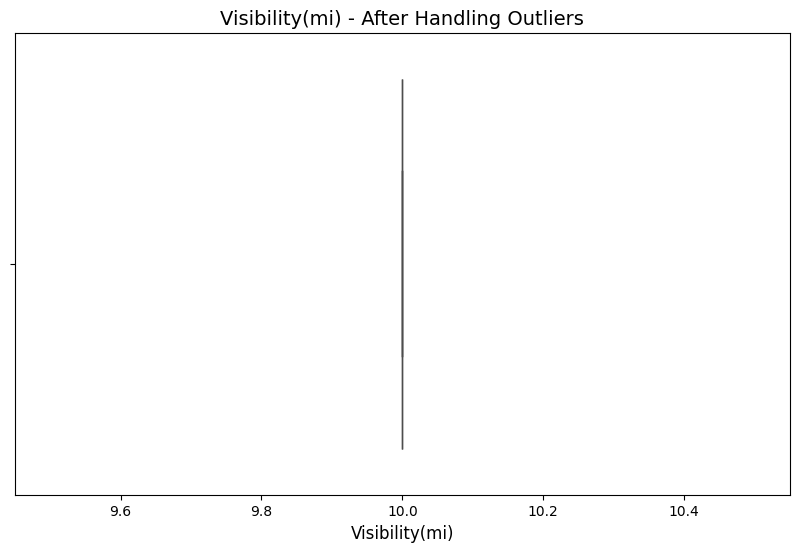


Analyzing column: Humidity(%)


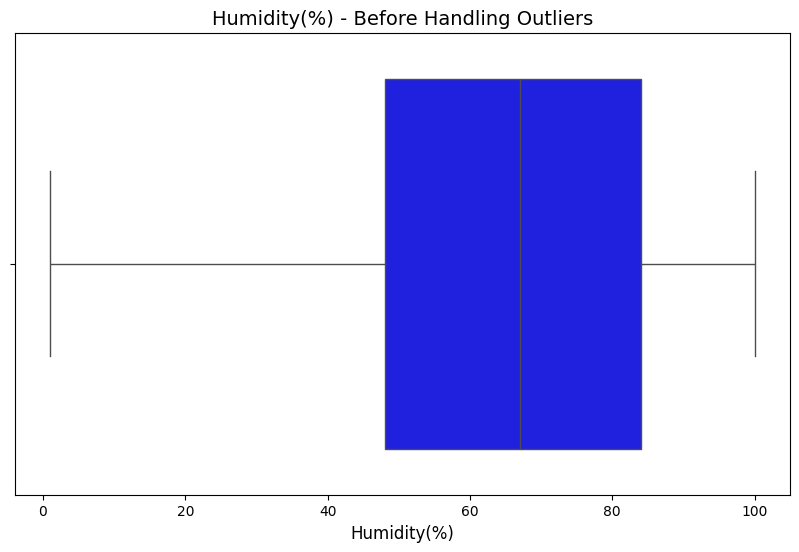


0 outliers detected in 'Humidity(%)' column.
Lower Bound: -6.00, Upper Bound: 138.00
Outliers handled in 'Humidity(%)'.
Visualizing Humidity(%) after handling outliers:


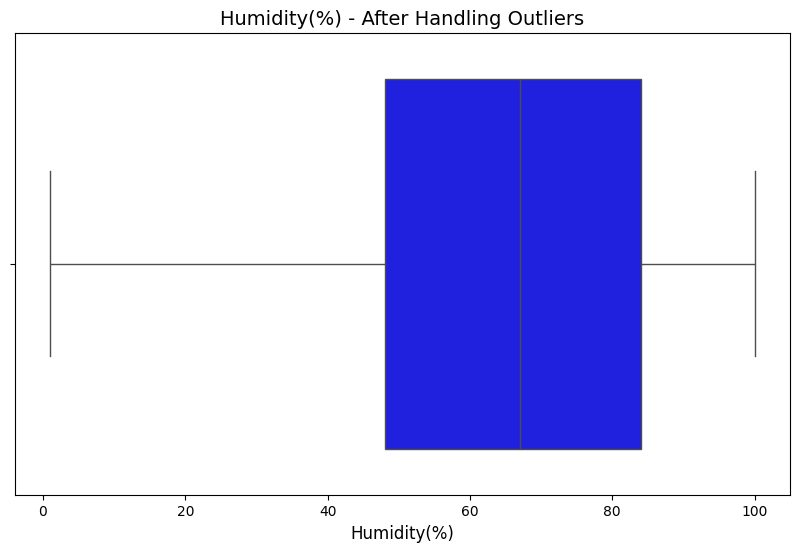


Analyzing column: Wind_Speed(mph)


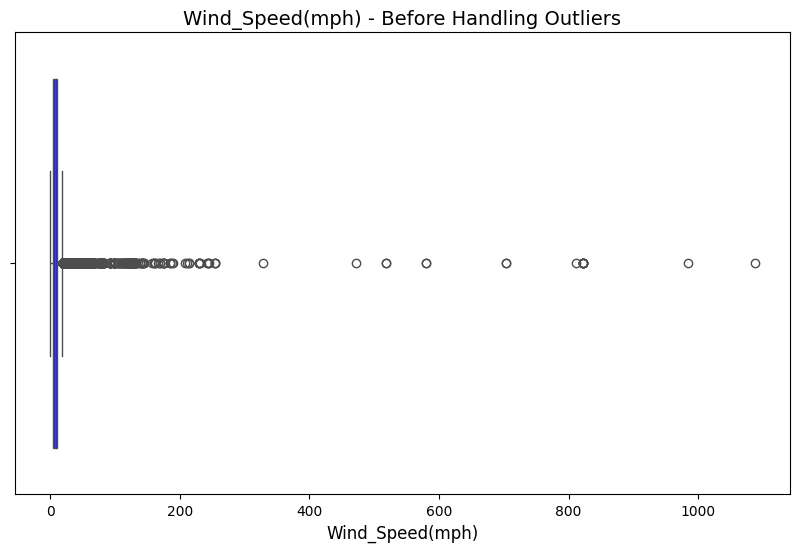


210603 outliers detected in 'Wind_Speed(mph)' column.
Lower Bound: -4.10, Upper Bound: 19.10
Outliers handled in 'Wind_Speed(mph)'.
Visualizing Wind_Speed(mph) after handling outliers:


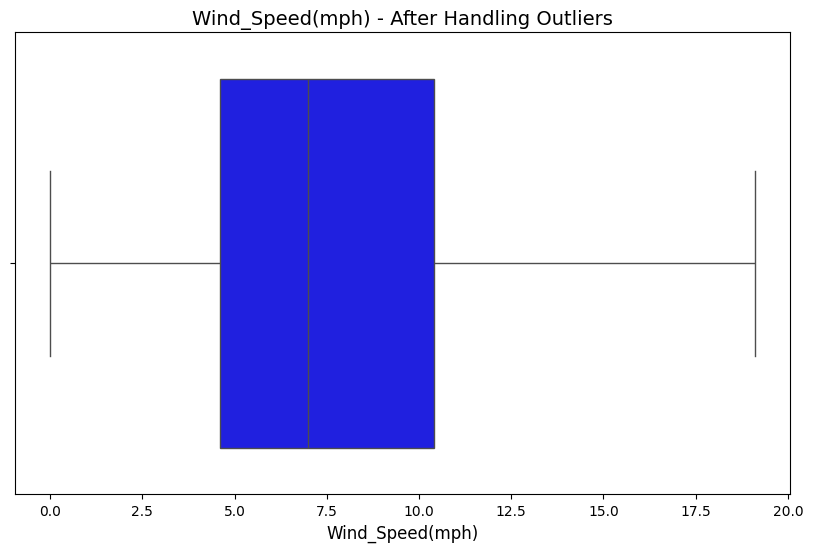


Analyzing column: Pressure(in)


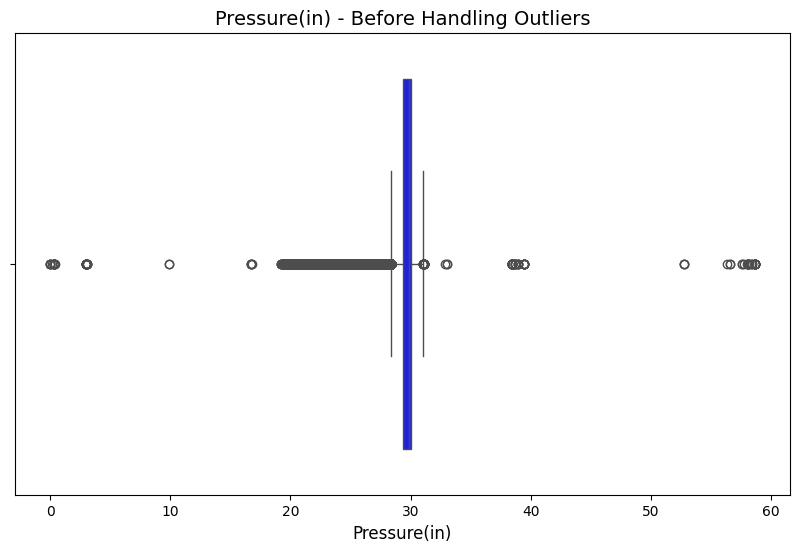


443383 outliers detected in 'Pressure(in)' column.
Lower Bound: 28.38, Upper Bound: 31.02
Outliers handled in 'Pressure(in)'.
Visualizing Pressure(in) after handling outliers:


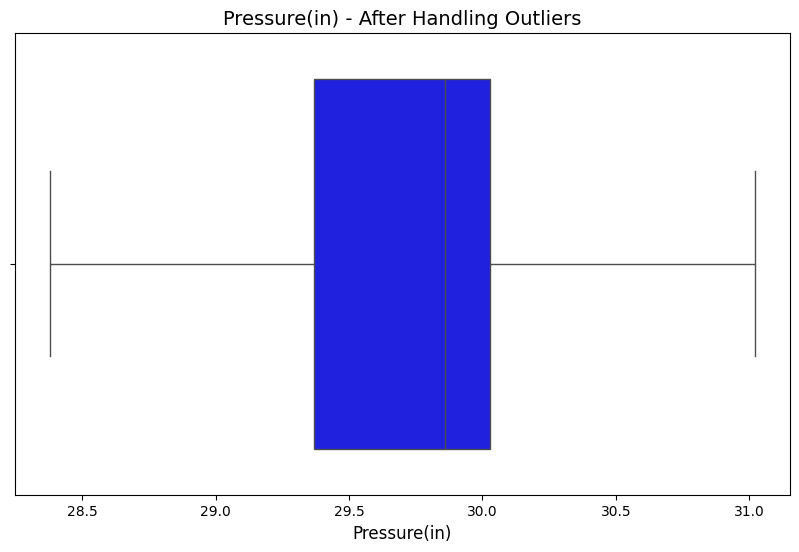


Analyzing column: Precipitation(in)


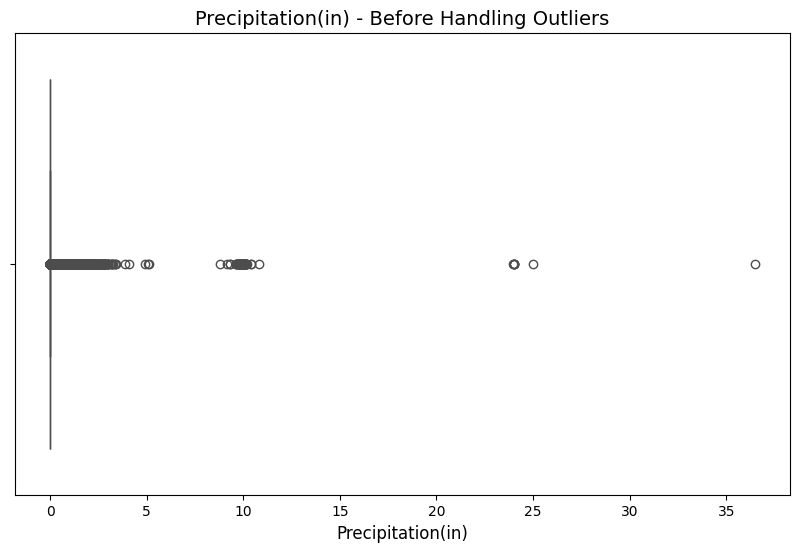


533090 outliers detected in 'Precipitation(in)' column.
Lower Bound: 0.00, Upper Bound: 0.00
Outliers handled in 'Precipitation(in)'.
Visualizing Precipitation(in) after handling outliers:


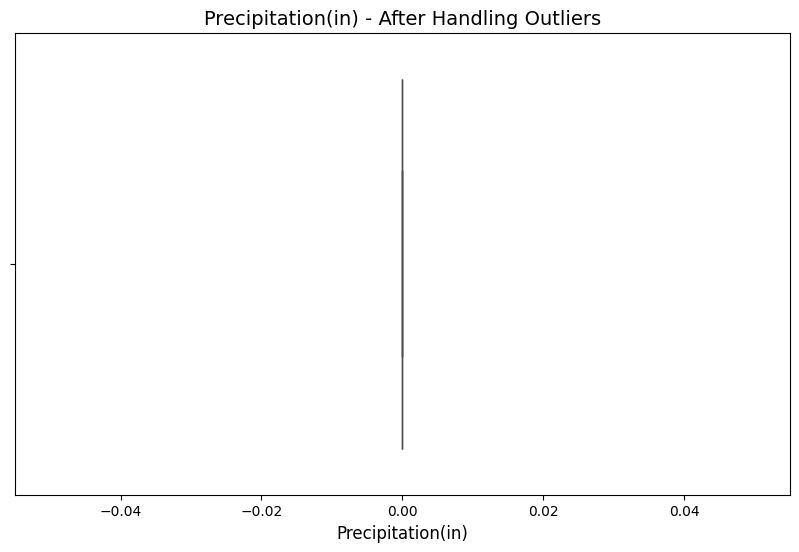


Analyzing column: Distance(mi)


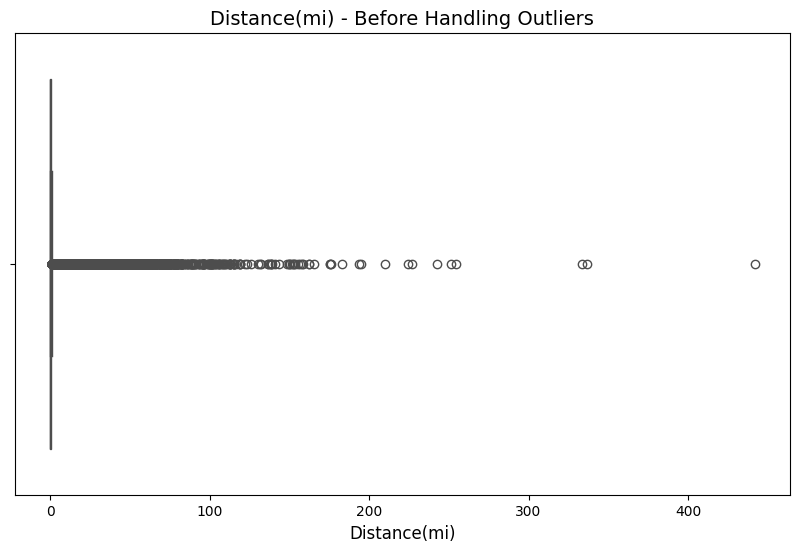


963606 outliers detected in 'Distance(mi)' column.
Lower Bound: -0.70, Upper Bound: 1.16
Outliers handled in 'Distance(mi)'.
Visualizing Distance(mi) after handling outliers:


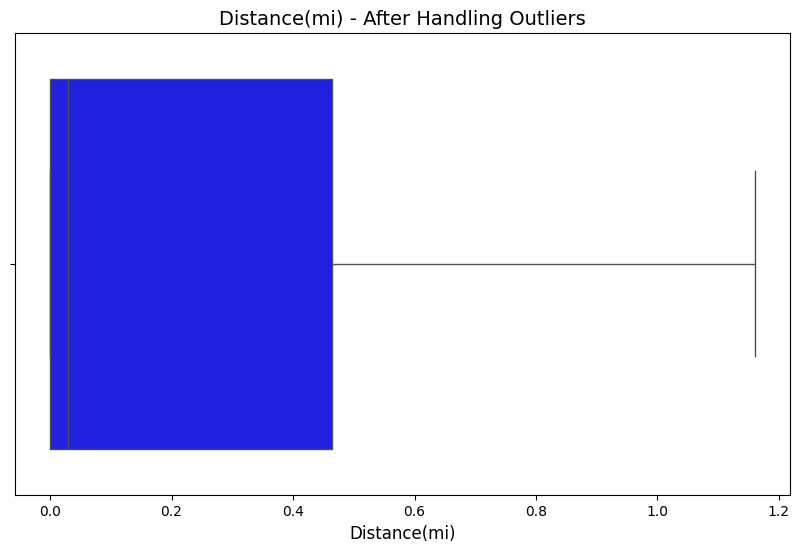


Analyzing column: Severity


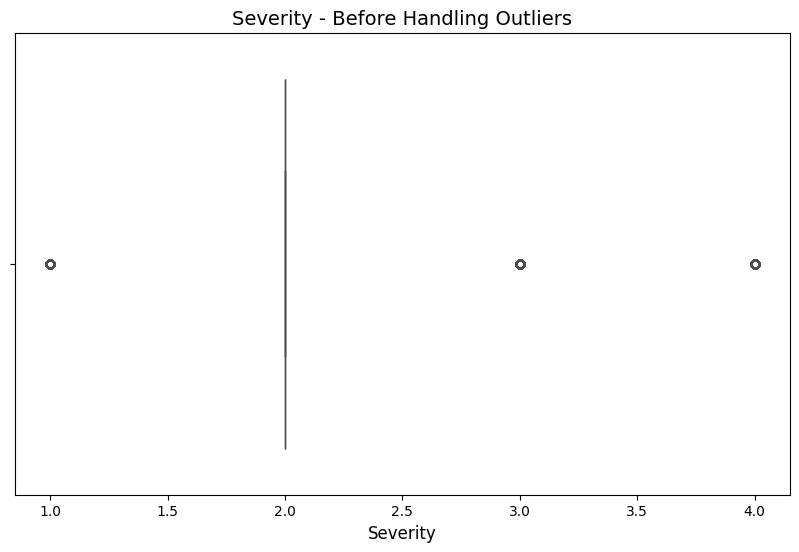


1571413 outliers detected in 'Severity' column.
Lower Bound: 2.00, Upper Bound: 2.00
Outliers handled in 'Severity'.
Visualizing Severity after handling outliers:


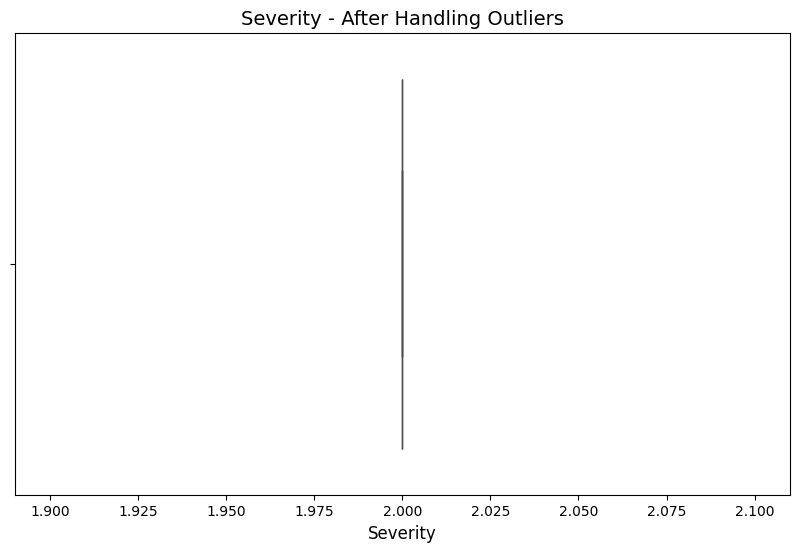


Analyzing column: Start_Lat


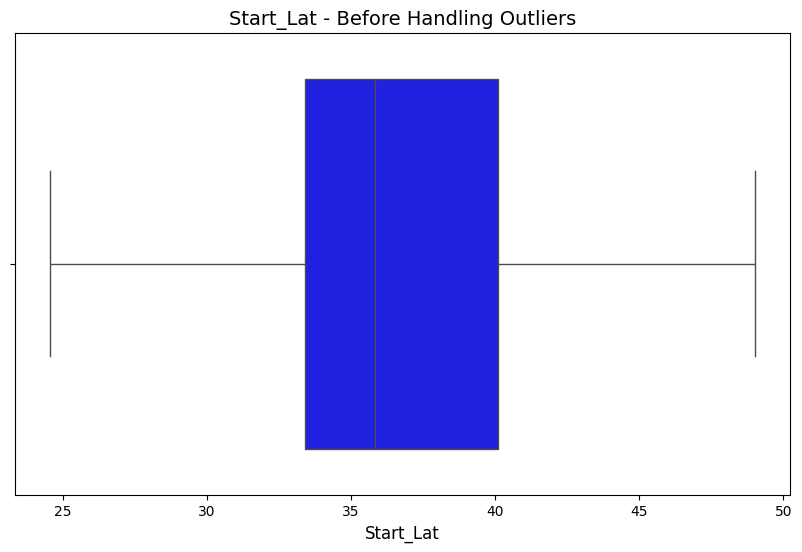


0 outliers detected in 'Start_Lat' column.
Lower Bound: 23.37, Upper Bound: 50.11
Outliers handled in 'Start_Lat'.
Visualizing Start_Lat after handling outliers:


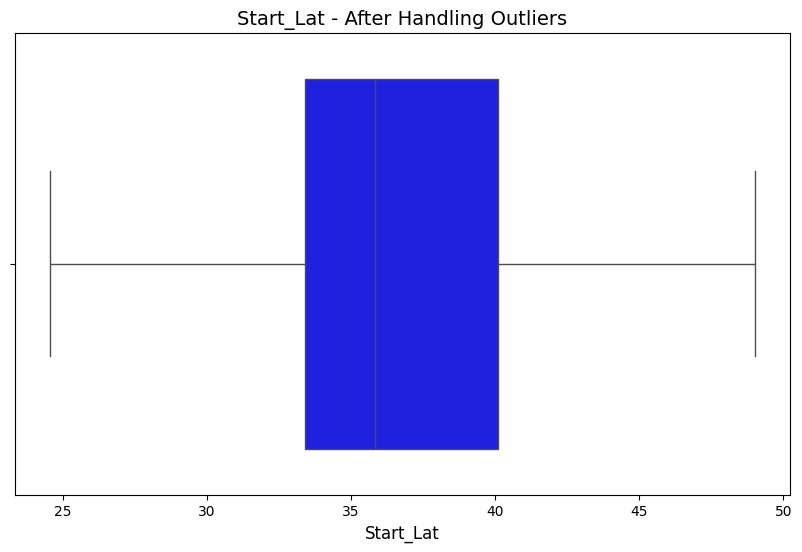


Analyzing column: Start_Lng


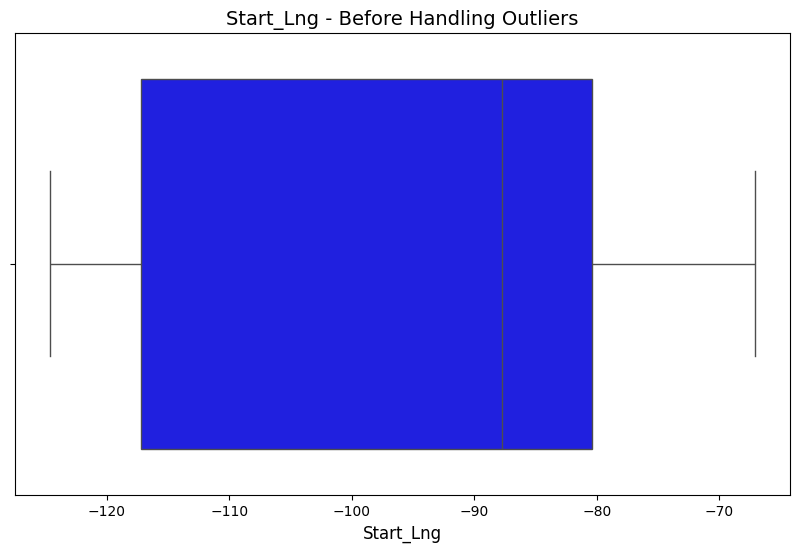


0 outliers detected in 'Start_Lng' column.
Lower Bound: -172.52, Upper Bound: -25.06
Outliers handled in 'Start_Lng'.
Visualizing Start_Lng after handling outliers:


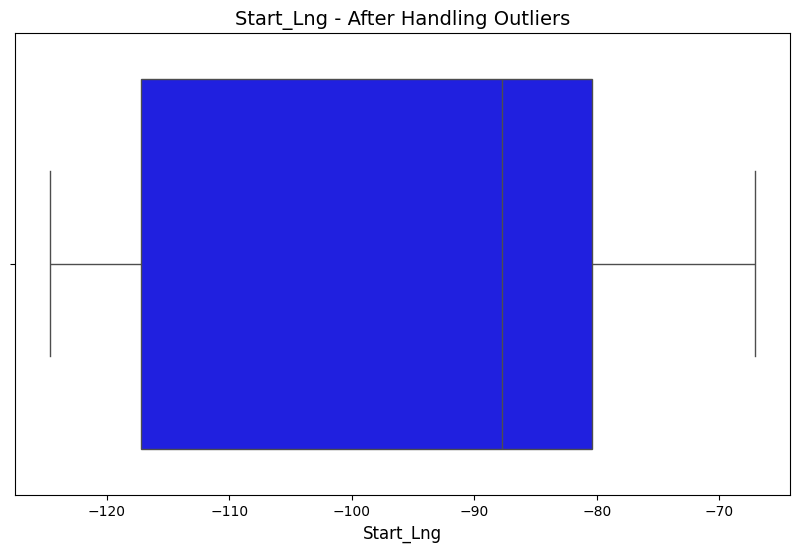

In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
file_path = '/Users/pratik/Desktop/Data Mining/Project/US_Accidents_March23.csv'  # Replace with your file path
try:
    dataset = pd.read_csv(file_path)
    print("Dataset loaded successfully.")
except FileNotFoundError:
    print(f"Error: File not found at {file_path}. Please check the file path.")
    dataset = None

# Function to detect outliers using the IQR method
def detect_outliers_iqr(data, column):
    Q1 = data[column].quantile(0.25)
    Q3 = data[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Find outliers
    outliers = data[(data[column] < lower_bound) | (data[column] > upper_bound)]
    return outliers, lower_bound, upper_bound

# Visualize outliers for specific columns
def visualize_outliers(data, column, title):
    plt.figure(figsize=(10, 6))
    sns.boxplot(x=data[column], color='blue')
    plt.title(title, fontsize=14)
    plt.xlabel(column, fontsize=12)
    plt.show()

# Handle outliers by capping them
def handle_outliers(data, column):
    outliers, lower_bound, upper_bound = detect_outliers_iqr(data, column)
    print(f"\n{len(outliers)} outliers detected in '{column}' column.")
    print(f"Lower Bound: {lower_bound:.2f}, Upper Bound: {upper_bound:.2f}")

    # Capping the outliers
    data[column] = np.where(data[column] < lower_bound, lower_bound, data[column])
    data[column] = np.where(data[column] > upper_bound, upper_bound, data[column])

    print(f"Outliers handled in '{column}'.")
    return data

if dataset is not None:
    # Columns to check for outliers
    columns_to_check = [
    'Temperature(F)',        # Temperature in Fahrenheit
    'Visibility(mi)',        # Visibility in miles
    'Humidity(%)',           # Humidity percentage
    'Wind_Speed(mph)',       # Wind speed in miles per hour
    'Pressure(in)',          # Atmospheric pressure in inches
    'Precipitation(in)',     # Precipitation in inches
    'Distance(mi)',          # Distance of the accident in miles
    'Severity',              # Accident severity level (1-4)
    'Start_Lat',             # Latitude of the accident
    'Start_Lng'              # Longitude of the accident
]
    for col in columns_to_check:
        if col in dataset.columns:
            print(f"\nAnalyzing column: {col}")

            # Visualize outliers before handling
            visualize_outliers(dataset, col, f"{col} - Before Handling Outliers")

            # Detect and handle outliers
            dataset = handle_outliers(dataset, col)

            # Visualize outliers after handling
            print(f"Visualizing {col} after handling outliers:")
            visualize_outliers(dataset, col, f"{col} - After Handling Outliers")
        else:
            print(f"Column '{col}' not found in the dataset.")
else:
    print("Dataset could not be loaded for analysis.")


Encoding Categorical Features

In [8]:
import pandas as pd
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split

# Load the dataset
file_path = '/Users/pratik/Desktop/Data Mining/Project/US_Accidents_March23.csv'  # Replace with your file path
try:
    dataset = pd.read_csv(file_path)
    print("Dataset loaded successfully.")
except FileNotFoundError:
    print(f"Error: File not found at {file_path}. Please check the file path.")
    dataset = None

if dataset is not None:
    # Step 1: Identify categorical columns and their unique counts
    categorical_columns = dataset.select_dtypes(include=['object']).columns
    unique_counts = {col: dataset[col].nunique() for col in categorical_columns}
    print("\nUnique value counts for categorical columns:")
    for col, count in unique_counts.items():
        print(f"{col}: {count}")

    # Step 2: Apply One-Hot Encoding selectively
    print("\nApplying One-Hot Encoding to selected columns...")
    one_hot_encoded_columns = [col for col, count in unique_counts.items() if count <= 10]  # Example: Columns with ≤10 unique values
    for col in one_hot_encoded_columns:
        dataset = pd.get_dummies(dataset, columns=[col], prefix=col, drop_first=True)

    # Step 3: Apply Label Encoding for high-cardinality columns
    print("\nApplying Label Encoding to high-cardinality columns...")
    label_encoded_columns = [col for col, count in unique_counts.items() if count > 10 and col != 'ID']
    label_encoder = LabelEncoder()
    for col in label_encoded_columns:
        dataset[col] = label_encoder.fit_transform(dataset[col].astype(str))

    # Step 4: Remove irrelevant or ID-like columns
    print("\nRemoving irrelevant columns...")
    irrelevant_columns = ['ID', 'Description', 'Weather_Timestamp']  # Adjust based on your dataset
    dataset = dataset.drop(columns=irrelevant_columns, errors='ignore')

    # Step 5: Train-Test Split
    target = 'Severity'  # Replace with your target column
    features = dataset.drop(columns=[target])  # Features exclude the target column
    labels = dataset[target]

    X_train, X_test, y_train, y_test = train_test_split(features, labels, test_size=0.2, random_state=42, stratify=labels)

    # Summary of encoded features
    print("\nDataset after encoding and feature removal:")
    print(dataset.head())

    print(f"\nShape of Training Set: {X_train.shape}")
    print(f"Shape of Test Set: {X_test.shape}")

else:
    print("Dataset could not be loaded for encoding.")



Dataset loaded successfully.

Unique value counts for categorical columns:
ID: 7728394
Source: 3
Start_Time: 6131796
End_Time: 6705355
Description: 3761578
Street: 336306
City: 13678
County: 1871
State: 49
Zipcode: 825094
Country: 1
Timezone: 4
Airport_Code: 2045
Weather_Timestamp: 941331
Wind_Direction: 24
Weather_Condition: 144
Sunrise_Sunset: 2
Civil_Twilight: 2
Nautical_Twilight: 2
Astronomical_Twilight: 2

Applying One-Hot Encoding to selected columns...

Applying Label Encoding to high-cardinality columns...

Removing irrelevant columns...

Dataset after encoding and feature removal:
   Severity  Start_Time  End_Time  Start_Lat  Start_Lng  End_Lat  End_Lng  \
0         3           2        22  39.865147 -84.058723      NaN      NaN   
1         2           4         1  39.928059 -82.831184      NaN      NaN   
2         2           6         2  39.063148 -84.032608      NaN      NaN   
3         3           8         3  39.747753 -84.205582      NaN      NaN   
4         2       

Normalizing the Dataset

In [9]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

# Load the dataset
file_path = '/Users/pratik/Desktop/Data Mining/Project/US_Accidents_March23.csv'  # Replace with your file path
try:
    dataset = pd.read_csv(file_path)
    print("Dataset loaded successfully.")
except FileNotFoundError:
    print(f"Error: File not found at {file_path}. Please check the file path.")
    dataset = None

if dataset is not None:
    # Select numeric columns for normalization
    numeric_columns = dataset.select_dtypes(include=['float64', 'int64']).columns

    # Check if there are numeric columns
    if len(numeric_columns) > 0:
        print("\nNumeric columns detected:")
        print(numeric_columns)

        # Normalize the numeric columns
        scaler = MinMaxScaler()
        dataset_normalized = dataset.copy()
        dataset_normalized[numeric_columns] = scaler.fit_transform(dataset[numeric_columns])

        print("\nNormalization completed. Here are the first few rows of the normalized dataset:")
        print(dataset_normalized.head())

        # Save normalized dataset if needed
        normalized_file_path = '/Users/pratik/Desktop/Data Mining/Project/US_Accidents_March23_Normalized.csv'
        dataset_normalized.to_csv(normalized_file_path, index=False)
        print(f"\nNormalized dataset saved to: {normalized_file_path}")
    else:
        print("No numeric columns found for normalization.")
else:
    print("Dataset could not be loaded.")


Dataset loaded successfully.

Numeric columns detected:
Index(['Severity', 'Start_Lat', 'Start_Lng', 'End_Lat', 'End_Lng',
       'Distance(mi)', 'Temperature(F)', 'Wind_Chill(F)', 'Humidity(%)',
       'Pressure(in)', 'Visibility(mi)', 'Wind_Speed(mph)',
       'Precipitation(in)'],
      dtype='object')

Normalization completed. Here are the first few rows of the normalized dataset:
    ID   Source  Severity           Start_Time             End_Time  \
0  A-1  Source2  0.666667  2016-02-08 05:46:00  2016-02-08 11:00:00   
1  A-2  Source2  0.333333  2016-02-08 06:07:59  2016-02-08 06:37:59   
2  A-3  Source2  0.333333  2016-02-08 06:49:27  2016-02-08 07:19:27   
3  A-4  Source2  0.666667  2016-02-08 07:23:34  2016-02-08 07:53:34   
4  A-5  Source2  0.333333  2016-02-08 07:39:07  2016-02-08 08:09:07   

   Start_Lat  Start_Lng  End_Lat  End_Lng  Distance(mi)  ... Roundabout  \
0   0.626257   0.705349      NaN      NaN      0.000023  ...      False   
1   0.628830   0.726694      NaN   

Multiclass Classifiers Modeling

In [1]:
import warnings
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.utils import resample
from scipy.stats import randint

# Suppress specific warnings
warnings.filterwarnings("ignore", category=UserWarning)

# Load the dataset
file_path = '/Users/pratik/Desktop/Data Mining/Project/US_Accidents_March23.csv'  # Replace with your file path
try:
    dataset = pd.read_csv(file_path)
    print("Dataset loaded successfully.")
except FileNotFoundError:
    print(f"Error: File not found at {file_path}. Please check the file path.")
    dataset = None

if dataset is not None:
    # Define target and features
    target = "Severity"  # Replace with your target column
    if target not in dataset.columns:
        raise ValueError(f"Target column '{target}' not found in the dataset.")

    # Drop rows with missing target or features
    dataset = dataset.dropna(subset=[target])

    # Select numeric columns as features
    numeric_columns = dataset.select_dtypes(include=['float64', 'int64']).columns
    numeric_columns = [col for col in numeric_columns if col != target]

    print("\nNumeric feature columns detected:")
    print(numeric_columns)

    # Split data into features (X) and target (y)
    X = dataset[numeric_columns]
    y = dataset[target]

    # Handle missing values in features
    X = X.fillna(X.median())

    # Encode target labels if they are not numeric
    if y.dtype == 'object':
        le = LabelEncoder()
        y = le.fit_transform(y)
        print("\nTarget labels encoded.")

    # Subsample the dataset for faster training
    if len(X) > 10000:
        X, y = resample(X, y, n_samples=10000, stratify=y, random_state=42)

    # Split into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

    # Normalize the features using StandardScaler
    scaler = StandardScaler()
    X_train = scaler.fit_transform(X_train)
    X_test = scaler.transform(X_test)

    # Random Forest with Randomized Search
    rf_model = RandomForestClassifier(random_state=42)
    rf_params = {
        "n_estimators": randint(50, 150),
        "max_depth": randint(5, 20),
        "min_samples_split": randint(2, 10)
    }

    rf_search = RandomizedSearchCV(
        rf_model,
        rf_params,
        n_iter=5,  # Reduced iterations for faster execution
        cv=3,
        scoring='accuracy',
        random_state=42,
        n_jobs=-1,
        verbose=1
    )
    rf_search.fit(X_train, y_train)
    best_rf = rf_search.best_estimator_

    # Evaluate Random Forest
    print("\nEvaluating Random Forest...")
    y_pred_rf = best_rf.predict(X_test)
    print(f"Accuracy: {accuracy_score(y_test, y_pred_rf):.4f}")
    print("\nClassification Report:")
    print(classification_report(y_test, y_pred_rf, zero_division=0))
    print("\nConfusion Matrix:")
    print(confusion_matrix(y_test, y_pred_rf))

    # SVM with a reduced dataset
    svm_model = SVC(probability=True, random_state=42)
    svm_params = {
        "C": [0.1, 1, 10],
        "kernel": ['linear', 'rbf']
    }

    svm_search = RandomizedSearchCV(
        svm_model,
        svm_params,
        n_iter=2,  # Further reduced iterations for faster execution
        cv=3,
        scoring='accuracy',
        random_state=42,
        n_jobs=-1,
        verbose=1
    )
    svm_search.fit(X_train, y_train)
    best_svm = svm_search.best_estimator_

    # Evaluate SVM
    print("\nEvaluating SVM...")
    y_pred_svm = best_svm.predict(X_test)
    print(f"Accuracy: {accuracy_score(y_test, y_pred_svm):.4f}")
    print("\nClassification Report:")
    print(classification_report(y_test, y_pred_svm, zero_division=0))
    print("\nConfusion Matrix:")
    print(confusion_matrix(y_test, y_pred_svm))

else:
    print("Dataset could not be loaded for analysis.")


Dataset loaded successfully.

Numeric feature columns detected:
['Start_Lat', 'Start_Lng', 'End_Lat', 'End_Lng', 'Distance(mi)', 'Temperature(F)', 'Wind_Chill(F)', 'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Speed(mph)', 'Precipitation(in)']
Fitting 3 folds for each of 5 candidates, totalling 15 fits

Evaluating Random Forest...
Accuracy: 0.8085

Classification Report:
              precision    recall  f1-score   support

           1       0.00      0.00      0.00        17
           2       0.83      0.97      0.89      1594
           3       0.56      0.23      0.32       336
           4       0.00      0.00      0.00        53

    accuracy                           0.81      2000
   macro avg       0.35      0.30      0.30      2000
weighted avg       0.75      0.81      0.76      2000


Confusion Matrix:
[[   0   16    1    0]
 [   0 1541   53    0]
 [   0  260   76    0]
 [   0   47    6    0]]
Fitting 3 folds for each of 2 candidates, totalling 6 fits

Evaluating

Convert Severity to Binary Classification

In [2]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

# Load the dataset
file_path = '/Users/pratik/Desktop/Data Mining/Project/US_Accidents_March23.csv'  # Replace with your file path
try:
    dataset = pd.read_csv(file_path)
    print("Dataset loaded successfully.")
except FileNotFoundError:
    print(f"Error: File not found at {file_path}. Please check the file path.")
    dataset = None

if dataset is not None:
    # Check if the 'Severity' column exists
    if 'Severity' not in dataset.columns:
        raise ValueError("The dataset must contain a 'Severity' column.")

    # Converting to binary classification:
    # Grouping Severity 1 and 2 as 'Low' (0) and Severity 3 and 4 as 'High' (1)
    dataset['Severity_Binary'] = dataset['Severity'].apply(lambda x: 1 if x > 2 else 0)
    print("\nConverted 'Severity' to binary classification:\n")
    print(dataset['Severity_Binary'].value_counts(normalize=True) * 100)

    # Define features and target
    target = 'Severity_Binary'
    features = ['Start_Lat', 'Start_Lng', 'Distance(mi)', 'Temperature(F)', 'Humidity(%)',
                'Pressure(in)', 'Visibility(mi)', 'Wind_Speed(mph)']  # Use relevant numeric columns
    features = [col for col in features if col in dataset.columns]

    # Drop rows with missing values in target or features
    dataset = dataset.dropna(subset=[target] + features)

    # Sample a subset of the dataset for faster execution
    if len(dataset) > 50000:  # Limit to 50,000 rows for quicker processing
        dataset = dataset.sample(n=50000, random_state=42)

    # Splitting into features (X) and target (y)
    X = dataset[features]
    y = dataset[target]

    # Train-test split
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

    # Model training using Random Forest
    rf_model = RandomForestClassifier(n_estimators=50, max_depth=10, random_state=42, n_jobs=-1)  # Reduced complexity
    rf_model.fit(X_train, y_train)

    # Predictions
    y_pred = rf_model.predict(X_test)

    # Model evaluation
    print("\nModel Evaluation:")
    print(f"Accuracy: {accuracy_score(y_test, y_pred):.4f}")
    print("\nClassification Report:")
    print(classification_report(y_test, y_pred, zero_division=0))
    print("\nConfusion Matrix:")
    print(confusion_matrix(y_test, y_pred))
else:
    print("Dataset could not be loaded for analysis.")


Dataset loaded successfully.

Converted 'Severity' to binary classification:

Severity_Binary
0    80.538686
1    19.461314
Name: proportion, dtype: float64

Model Evaluation:
Accuracy: 0.8177

Classification Report:
              precision    recall  f1-score   support

           0       0.82      1.00      0.90      8133
           1       0.77      0.03      0.06      1867

    accuracy                           0.82     10000
   macro avg       0.79      0.52      0.48     10000
weighted avg       0.81      0.82      0.74     10000


Confusion Matrix:
[[8114   19]
 [1804   63]]


Binary Classifiers modeling

Dataset loaded successfully.

Performing hyperparameter tuning for LogisticRegression...

Performing hyperparameter tuning for RandomForestClassifier...

Performing hyperparameter tuning for SVC...

Performing hyperparameter tuning for LinearDiscriminantAnalysis...

Performing hyperparameter tuning for ExtraTreesClassifier...

Performing hyperparameter tuning for BaggingClassifier...

Performing hyperparameter tuning for KNeighborsClassifier...

Performing hyperparameter tuning for Perceptron...


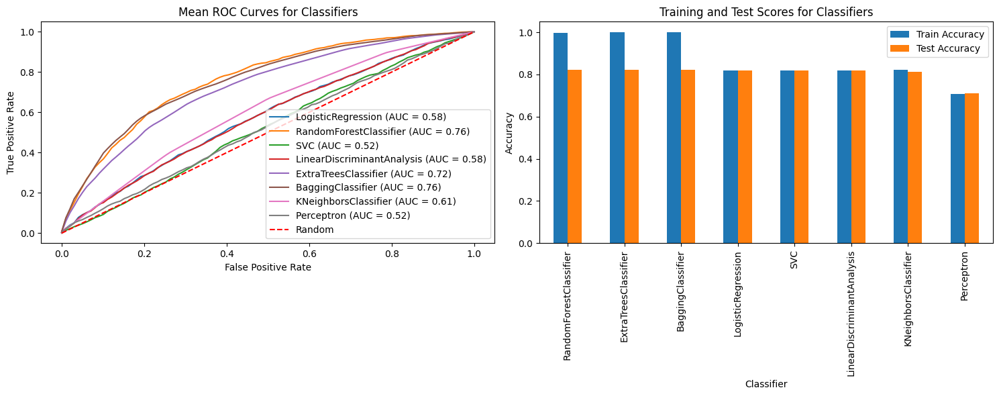

╒════╤════════════════════════════╤═══════════════════════════════════════╤══════════════════╤═════════════════╤════════════════╤══════════════════╤═══════════════╤═════════════════╕
│    │ Classifier                 │ Best Params                           │   Train Accuracy │   Test Accuracy │   Mean ROC AUC │   Mean Precision │   Mean Recall │   Mean F1 Score │
╞════╪════════════════════════════╪═══════════════════════════════════════╪══════════════════╪═════════════════╪════════════════╪══════════════════╪═══════════════╪═════════════════╡
│  1 │ RandomForestClassifier     │ {'max_depth': 20, 'n_estimators': 50} │         0.99585  │          0.8224 │       0.763971 │         0.540587 │     0.133232  │       0.213559  │
├────┼────────────────────────────┼───────────────────────────────────────┼──────────────────┼─────────────────┼────────────────┼──────────────────┼───────────────┼─────────────────┤
│  4 │ ExtraTreesClassifier       │ {'n_estimators': 50}                  │         1

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import StratifiedKFold, train_test_split, GridSearchCV
from sklearn.metrics import roc_curve, auc, precision_score, recall_score, f1_score, accuracy_score
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression, Perceptron, RidgeClassifier
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier, BaggingClassifier
from sklearn.svm import SVC, LinearSVC
from sklearn.calibration import CalibratedClassifierCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.utils import shuffle
from tabulate import tabulate
import warnings

# Ignore warnings
warnings.filterwarnings("ignore")

# Load the dataset
file_path = '/Users/pratik/Desktop/Data Mining/Project/US_Accidents_March23.csv'  # Replace with your file path
try:
    dataset = pd.read_csv(file_path)
    print("Dataset loaded successfully.")
except FileNotFoundError:
    print(f"Error: File not found at {file_path}. Please check the file path.")
    dataset = None

if dataset is not None:
    # Convert target to binary classification (e.g., Severity > 2 as 1, otherwise 0)
    dataset['Severity_Binary'] = dataset['Severity'].apply(lambda x: 1 if x > 2 else 0)

    # Select numeric features for classification
    numeric_columns = ['Start_Lat', 'Start_Lng', 'Distance(mi)', 'Temperature(F)', 'Humidity(%)',
                       'Pressure(in)', 'Visibility(mi)', 'Wind_Speed(mph)']
    numeric_columns = [col for col in numeric_columns if col in dataset.columns]
    dataset = dataset.dropna(subset=['Severity_Binary'] + numeric_columns)

    # Subsample for faster evaluation
    if len(dataset) > 10000:
        dataset = shuffle(dataset, random_state=42).sample(10000)

    # Split dataset into features and target
    X = dataset[numeric_columns]
    y = dataset['Severity_Binary']

    # Normalize features
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # Define classifiers and their hyperparameter grids
    classifiers = {
        'LogisticRegression': (LogisticRegression(max_iter=200), {'C': [0.1, 1, 10]}),
        'RandomForestClassifier': (RandomForestClassifier(), {'n_estimators': [50, 100], 'max_depth': [10, 20]}),
        'SVC': (SVC(probability=True), {'C': [0.1, 1, 10], 'kernel': ['linear', 'rbf']}),
        'LinearDiscriminantAnalysis': (LinearDiscriminantAnalysis(), {'solver': ['svd', 'lsqr']}),
        'ExtraTreesClassifier': (ExtraTreesClassifier(), {'n_estimators': [50, 100]}),
        'BaggingClassifier': (BaggingClassifier(), {'n_estimators': [10, 50]}),
        'KNeighborsClassifier': (KNeighborsClassifier(), {'n_neighbors': [5, 10]}),
        'Perceptron': (Perceptron(), {'alpha': [0.0001, 0.001]})
    }

    # Create an empty list to store results
    results_list = []

    # Create mean_fpr for ROC curves
    mean_fpr = np.linspace(0, 1, 100)

    # Initialize subplots for ROC curves and accuracies
    fig, (ax_roc, ax_acc) = plt.subplots(1, 2, figsize=(15, 6))

    # Perform hyperparameter tuning and 5-fold cross-validation
    for clf_name, (clf, param_grid) in classifiers.items():
        print(f"\nPerforming hyperparameter tuning for {clf_name}...")
        
        # StratifiedKFold for consistent evaluation
        cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

        # Hyperparameter tuning
        grid_search = GridSearchCV(clf, param_grid, cv=cv, scoring='accuracy', n_jobs=-1)
        grid_search.fit(X_scaled, y)

        # Best model and hyperparameters
        best_model = grid_search.best_estimator_
        best_params = grid_search.best_params_

        # Perform cross-validation with the best model
        train_scores = []
        test_scores = []
        tprs = []
        aucs = []
        precisions = []
        recalls = []
        f1_scores = []

        for train_idx, test_idx in cv.split(X_scaled, y):
            X_train, X_test = X_scaled[train_idx], X_scaled[test_idx]
            y_train, y_test = y.iloc[train_idx], y.iloc[test_idx]

            best_model.fit(X_train, y_train)

            # Training accuracy
            y_train_pred = best_model.predict(X_train)
            train_scores.append(accuracy_score(y_train, y_train_pred))

            # Testing accuracy
            y_test_pred = best_model.predict(X_test)
            test_scores.append(accuracy_score(y_test, y_test_pred))

            # ROC Curve and AUC
            if hasattr(best_model, 'predict_proba'):
                y_prob = best_model.predict_proba(X_test)[:, 1]
            else:
                y_prob = best_model.decision_function(X_test)
            
            fpr, tpr, _ = roc_curve(y_test, y_prob)
            tprs.append(np.interp(mean_fpr, fpr, tpr))  # Replaced scipy.interp with numpy.interp
            aucs.append(auc(fpr, tpr))

            # Precision, recall, F1
            precisions.append(precision_score(y_test, y_test_pred))
            recalls.append(recall_score(y_test, y_test_pred))
            f1_scores.append(f1_score(y_test, y_test_pred))

        # Plot ROC curve
        ax_roc.plot(mean_fpr, np.mean(tprs, axis=0), label=f'{clf_name} (AUC = {np.mean(aucs):.2f})')

        # Store results
        results_list.append({
            'Classifier': clf_name,
            'Best Params': best_params,
            'Train Accuracy': np.mean(train_scores),
            'Test Accuracy': np.mean(test_scores),
            'Mean ROC AUC': np.mean(aucs),
            'Mean Precision': np.mean(precisions),
            'Mean Recall': np.mean(recalls),
            'Mean F1 Score': np.mean(f1_scores)
        })

    # Finalize ROC curve plot
    ax_roc.plot([0, 1], [0, 1], linestyle='--', color='red', label='Random')
    ax_roc.set_title('Mean ROC Curves for Classifiers')
    ax_roc.set_xlabel('False Positive Rate')
    ax_roc.set_ylabel('True Positive Rate')
    ax_roc.legend(loc='lower right')

    # Create DataFrame from results and sort
    results_df = pd.DataFrame(results_list).sort_values(by='Test Accuracy', ascending=False)

    # Plot accuracy comparison
    results_df.plot(x='Classifier', y=['Train Accuracy', 'Test Accuracy'], kind='bar', ax=ax_acc)
    ax_acc.set_title('Training and Test Scores for Classifiers')
    ax_acc.set_ylabel('Accuracy')
    ax_acc.set_xlabel('Classifier')

    # Show plots
    plt.tight_layout()
    plt.show()

    # Print tabular summary
    print(tabulate(results_df, headers='keys', tablefmt='fancy_grid'))
else:
    print("Dataset could not be loaded.")
